# Chapitre 5 - Analyse descriptive pour l'étude communale

In [1]:
# Paramètre(s) du notebook

# VERBOSE=True
VERBOSE=False

OPTIONS=""
if not VERBOSE:
    OPTIONS="--quiet"

In [20]:
!pip install geopandas $OPTIONS
!pip install plotly $OPTIONS

In [21]:
import matplotlib.pyplot as plt
import geopandas as gpd
import pandas as pd 
import plotly.express as px
from IPython.core.display import display, HTML

In [4]:
def asciiprint(variable,desc):
    print("-"*100)
    print(variable,":",desc)
    print("-"*100)

def showgraph(departements,df,dep_idf,df_idf,var,color,label):
    asciiprint(var,label)
    fig, ax = plt.subplots(figsize=(10,10))

    departements.plot(color='gray', ax=ax)
    df.plot(column=var, 
                        cmap=color, 
                        linewidth=0.5, 
                        edgecolor='black',
                        ax=ax, 
                        legend=True,
                        legend_kwds={'label': label, 'orientation': "horizontal"})
    ax.set_axis_off()
    
    fig, ax = plt.subplots(figsize=(10,10))

    dep_idf.plot(color='gray', ax=ax)
    df_idf.plot(column=var, 
                        cmap=color, 
                        linewidth=0.5, 
                        edgecolor='black',
                        ax=ax, 
                        legend=True,
                        legend_kwds={'label': label, 'orientation': "horizontal"})
    ax.set_axis_off()

## 1) Chargement des données (Récup_données) et téléchargement de la localisation des départements français (restreint au champ métropolitain puis champ Ile de France)

In [5]:
%store -r donnees_2018_com_hab
if VERBOSE:
    display(donnees_2018_com_hab)

,NCC,geocodage_x_GPS_x,geocodage_y_GPS_x,Police_x,geocodage_x_GPS_y,geocodage_y_GPS_y,Police_y,CODREG,REG,CODDEP,...,RD18,libgeo,an,sexe,tx_chom1524,Total des crimes et délits relevés par la PN et GN,NbBoucheriesParComHab,Crim_Del_GN_hab,Crim_Del_PN_hab,Crim_Del_PN_GN_hab
01001,ABERGEMENT CLEMENCIAT,NaN,NaN,NaN,NaN,NaN,NaN,84,Auvergne-Rhône-Alpes,01,...,NaN,L'Abergement-Clémenciat,2018,T,30.8,0.0,0.0,NaN,NaN,0.0
01002,ABERGEMENT DE VAREY,NaN,NaN,NaN,NaN,NaN,NaN,84,Auvergne-Rhône-Alpes,01,...,NaN,L'Abergement-de-Varey,2018,T,66.7,0.0,0.0,NaN,NaN,0.0
01004,AMBERIEU EN BUGEY,NaN,NaN,NaN,NaN,NaN,NaN,84,Auvergne-Rhône-Alpes,01,...,3.2,Ambérieu-en-Bugey,2018,T,25.9,0.0,48.0,NaN,NaN,0.0
01005,AMBERIEUX EN DOMBES,NaN,NaN,NaN,NaN,NaN,NaN,84,Auvergne-Rhône-Alpes,01,...,NaN,Ambérieux-en-Dombes,2018,T,9.2,0.0,0.0,NaN,NaN,0.0
01006,AMBLEON,NaN,NaN,NaN,NaN,NaN,NaN,84,Auvergne-Rhône-Alpes,01,...,NaN,Ambléon,2018,T,42.9,0.0,0.0,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95676,VILLERS EN ARTHIES,NaN,NaN,NaN,NaN,NaN,NaN,11,Île-de-France,95,...,NaN,Villers-en-Arthies,2018,T,14.3,0.0,0.0,NaN,NaN,0.0
95678,VILLIERS ADAM,NaN,NaN,NaN,NaN,NaN,NaN,11,Île-de-France,95,...,NaN,Villiers-Adam,2018,T,26.5,0.0,0.0,NaN,NaN,0.0
95680,VILLIERS LE BEL,NaN,NaN,NaN,NaN,NaN,NaN,11,Île-de-France,95,...,NaN,Villiers-le-Bel,2018,T,32.4,0.0,39.0,NaN,NaN,0.0
95682,VILLIERS LE SEC,NaN,NaN,NaN,NaN,NaN,NaN,11,Île-de-France,95,...,NaN,Villiers-le-Sec,2018,T,30.0,0.0,0.0,NaN,NaN,0.0


In [6]:
url_com = 'https://www.data.gouv.fr/fr/datasets/r/2d037659-4ce2-4db9-9f10-11b2ff536194'
communes = gpd.read_file(url_com)
communes = communes.sort_values(by = ['insee'], ascending = True)
communes = communes.set_index("insee")
communes = communes[communes.index.str[:2]!='97']
communes.drop(['wikipedia', 'surf_ha','nom'], axis=1, inplace = True)
if VERBOSE:
    display(communes)

,geometry
insee,
01001,"POLYGON ((4.90298 46.15828, 4.90299 46.15835, ..."
01002,"POLYGON ((5.40408 46.00793, 5.40434 46.00813, ..."
01004,"POLYGON ((5.32722 45.95685, 5.32740 45.95680, ..."
01005,"POLYGON ((4.87552 45.98726, 4.87564 45.98729, ..."
01006,"POLYGON ((5.57068 45.75369, 5.57255 45.75382, ..."
...,...
95676,"POLYGON ((1.70345 49.07909, 1.70371 49.07954, ..."
95678,"POLYGON ((2.20277 49.06492, 2.20311 49.06497, ..."
95680,"POLYGON ((2.37885 49.00688, 2.37892 49.00727, ..."


In [7]:
#Restriction au champ IDF pour une sous-carte
communes_idf = communes.loc[communes.index.str[:2].isin(['75','77','78','91','92','93','94','95'])]

if VERBOSE:
    display(communes_idf)

,geometry
insee,
75056,"POLYGON ((2.22412 48.85420, 2.22416 48.85461, ..."
77001,"POLYGON ((2.54115 48.32594, 2.54200 48.32794, ..."
77002,"POLYGON ((3.10659 48.71325, 3.10664 48.71423, ..."
77003,"POLYGON ((2.50261 48.28749, 2.50310 48.28754, ..."
77004,"POLYGON ((2.76570 48.60594, 2.76572 48.60596, ..."
...,...
95676,"POLYGON ((1.70345 49.07909, 1.70371 49.07954, ..."
95678,"POLYGON ((2.20277 49.06492, 2.20311 49.06497, ..."
95680,"POLYGON ((2.37885 49.00688, 2.37892 49.00727, ..."


## 2) Sélection des items que l'on souhaite représenter (au champ métropolitain puis IDF) 

In [8]:

donnees_2018_com_hab.index.names = ['CODCOM']

if VERBOSE:
    pd.set_option('max_columns', None)
    display(donnees_2018_com_hab.describe())


In [9]:
donnees_2018_hab_pauvrete = donnees_2018_com_hab['TP6018'].to_frame()
donnees_2018_hab_rev_median = donnees_2018_com_hab['MED18'].to_frame()
donnees_2018_hab_ratio_d1_d9 = donnees_2018_com_hab['RD18'].to_frame()
donnees_2018_hab_chomage = donnees_2018_com_hab['tx_chom1524'].to_frame()
donnees_2018_hab_boucherie = donnees_2018_com_hab['NbBoucheriesParComHab'].to_frame()
donnees_2018_hab_nb_crimes_delits = donnees_2018_com_hab['Crim_Del_PN_GN_hab'].to_frame()


In [10]:
carto_pauvrete=communes.merge(donnees_2018_hab_pauvrete,left_index=True,right_index=True)
carto_rev_median=communes.merge(donnees_2018_hab_rev_median,left_index=True,right_index=True)
carto_ratio_d1_d9=communes.merge(donnees_2018_hab_ratio_d1_d9,left_index=True,right_index=True)
carto_chomage=communes.merge(donnees_2018_hab_chomage,left_index=True,right_index=True)
carto_boucherie=communes.merge(donnees_2018_hab_boucherie,left_index=True,right_index=True)
carto_crimes_delits=communes.merge(donnees_2018_hab_nb_crimes_delits,left_index=True,right_index=True)


In [11]:
#Restriction au champ IDF pour une sous-carte
carto_pauvrete_idf = carto_pauvrete.loc[carto_pauvrete.index.str[:2].isin(['75','77','78','91','92','93','94','95'])]
carto_rev_median_idf = carto_rev_median.loc[carto_rev_median.index.str[:2].isin(['75','77','78','91','92','93','94','95'])]
carto_ratio_d1_d9_idf = carto_ratio_d1_d9.loc[carto_ratio_d1_d9.index.str[:2].isin(['75','77','78','91','92','93','94','95'])]
carto_chomage_idf = carto_chomage.loc[carto_chomage.index.str[:2].isin(['75','77','78','91','92','93','94','95'])]
carto_boucherie_idf = carto_boucherie.loc[carto_boucherie.index.str[:2].isin(['75','77','78','91','92','93','94','95'])]
carto_crimes_delits_idf = carto_crimes_delits.loc[carto_crimes_delits.index.str[:2].isin(['75','77','78','91','92','93','94','95'])]


## 3) Représentation cartographique cloropèthe (au champ France Métropolitaine puis champ Ile de France) 

* Taux de pauvreté monétaire

----------------------------------------------------------------------------------------------------
TP6018 : Taux de pauvreté monétaire (au seuil de 60% du niveau de vie médian)
----------------------------------------------------------------------------------------------------


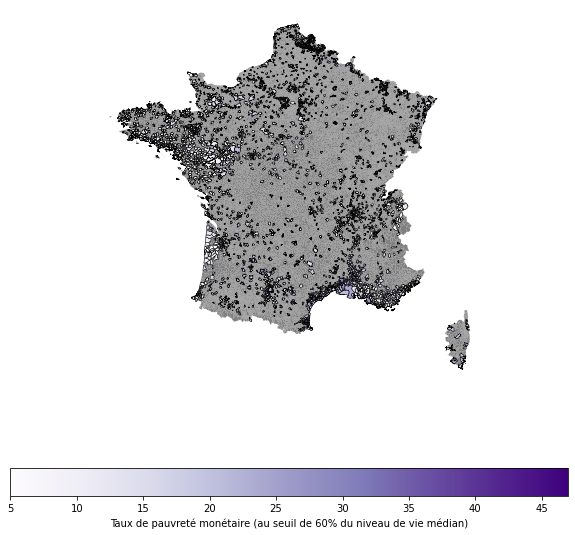

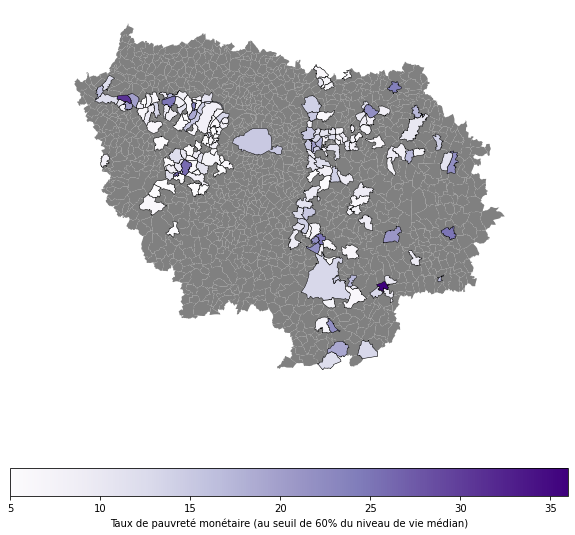

In [12]:
showgraph(communes,carto_pauvrete,communes_idf,carto_pauvrete_idf,'TP6018','Purples','Taux de pauvreté monétaire (au seuil de 60% du niveau de vie médian)')


* Niveau de vie médian

----------------------------------------------------------------------------------------------------
MED18 : Niveau de vie médian (en euros)
----------------------------------------------------------------------------------------------------


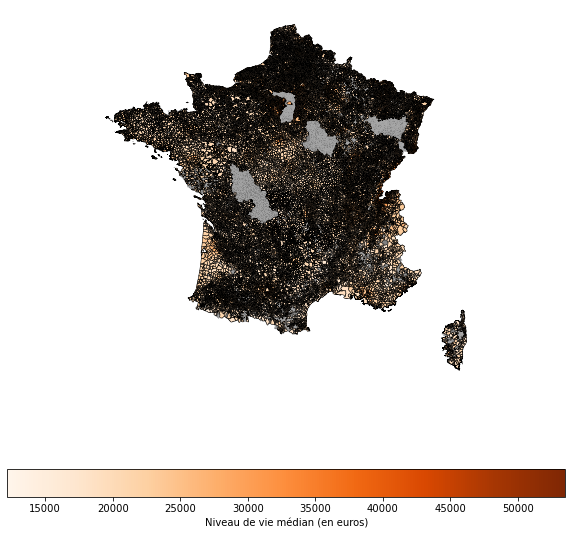

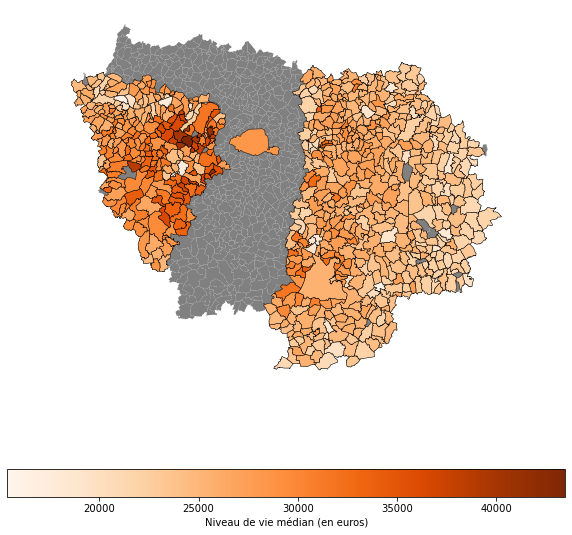

In [13]:
showgraph(communes,carto_rev_median,communes_idf,carto_rev_median_idf,'MED18','Oranges','Niveau de vie médian (en euros)')

* Ratio inter-décile de niveau de vie 

----------------------------------------------------------------------------------------------------
RD18 : Ratio inter-décile de niveau de vie
----------------------------------------------------------------------------------------------------


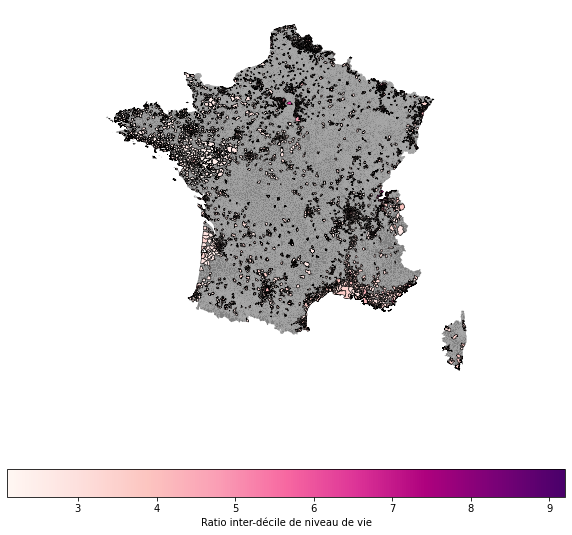

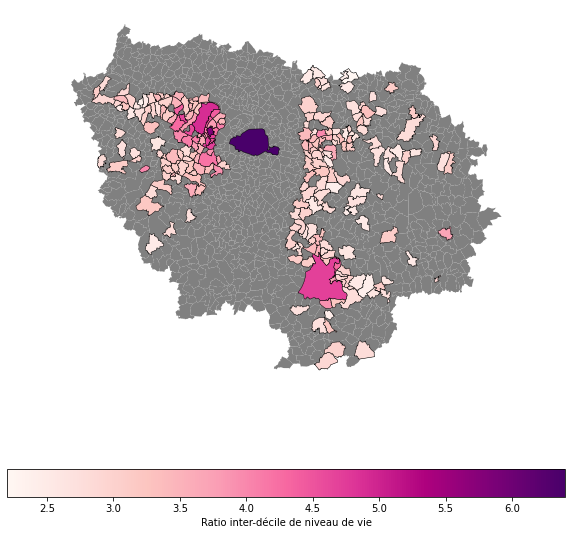

In [14]:
showgraph(communes,carto_ratio_d1_d9,communes_idf,carto_ratio_d1_d9_idf,'RD18','RdPu','Ratio inter-décile de niveau de vie')

* Taux de chômage localisé

----------------------------------------------------------------------------------------------------
tx_chom1524 : Taux de chômage localisé (en pourcentage)
----------------------------------------------------------------------------------------------------


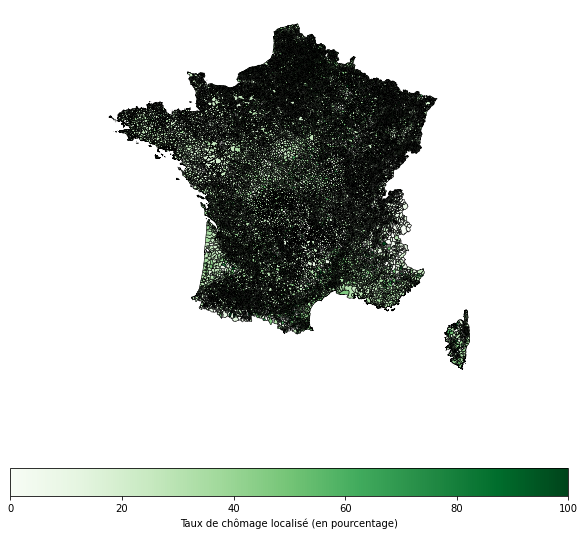

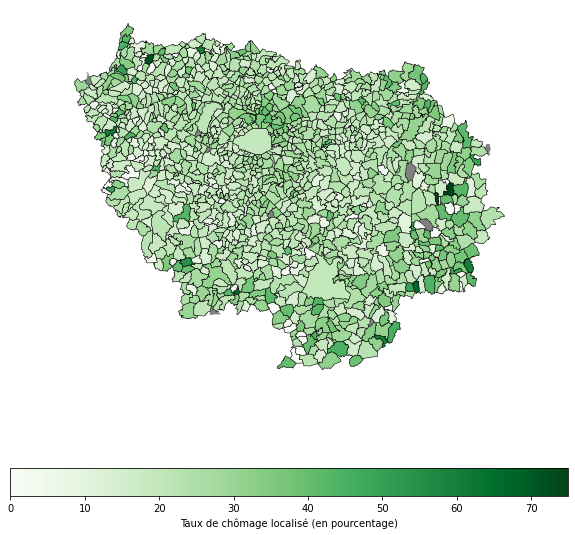

In [15]:
showgraph(communes,carto_chomage,communes_idf,carto_chomage_idf,'tx_chom1524','Greens','Taux de chômage localisé (en pourcentage)')

* Nombre de boucheries pour 100k habitants

----------------------------------------------------------------------------------------------------
NbBoucheriesParComHab : Nombre de boucheries-charcuteries pour 100 000 habitants
----------------------------------------------------------------------------------------------------


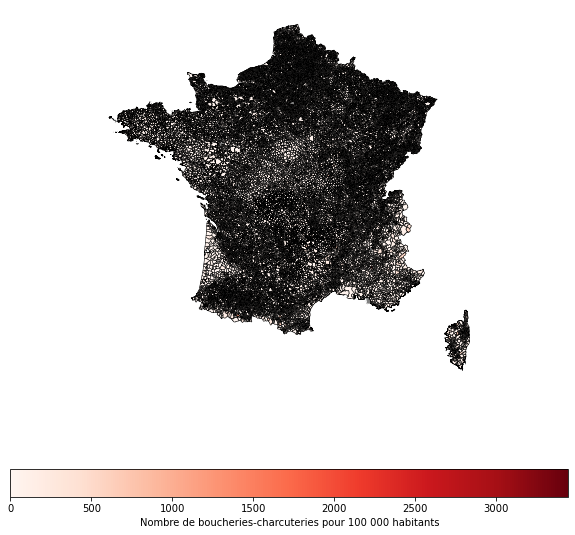

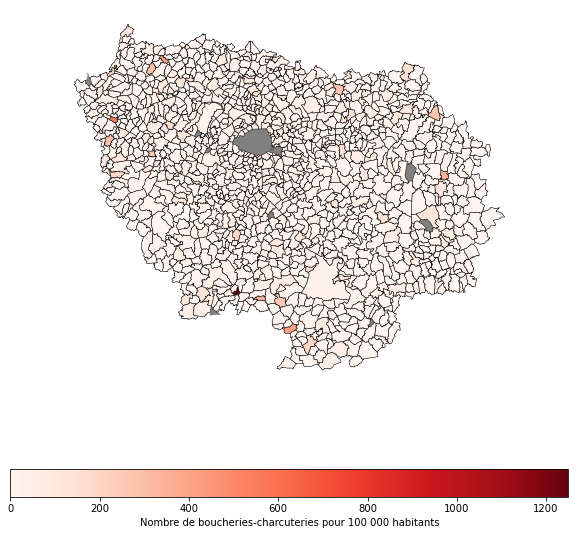

In [16]:
showgraph(communes,carto_boucherie,communes_idf,carto_boucherie_idf,'NbBoucheriesParComHab','Reds','Nombre de boucheries-charcuteries pour 100 000 habitants')

* Nombre de crimes et délits répertoriés pour 100k habitants

----------------------------------------------------------------------------------------------------
Crim_Del_PN_GN_hab : Nombre de crimes et délits répertoriés pour 100 000 habitants
----------------------------------------------------------------------------------------------------


/opt/conda/lib/python3.9/site-packages/matplotlib/colors.py:1202: RuntimeWarning: invalid value encountered in true_divide
  resdat /= (vmax - vmin)


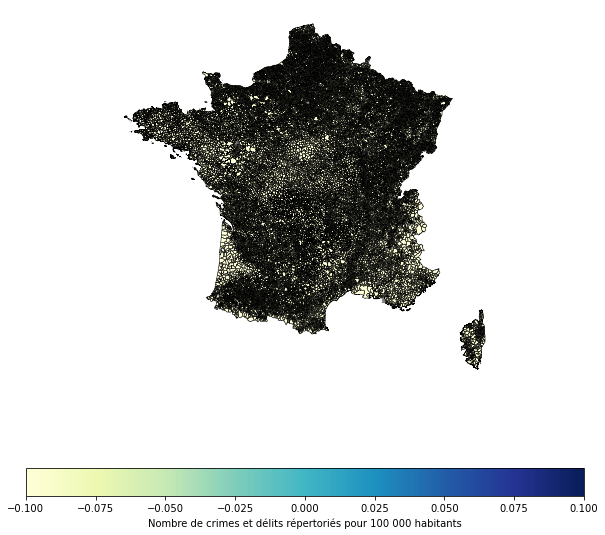

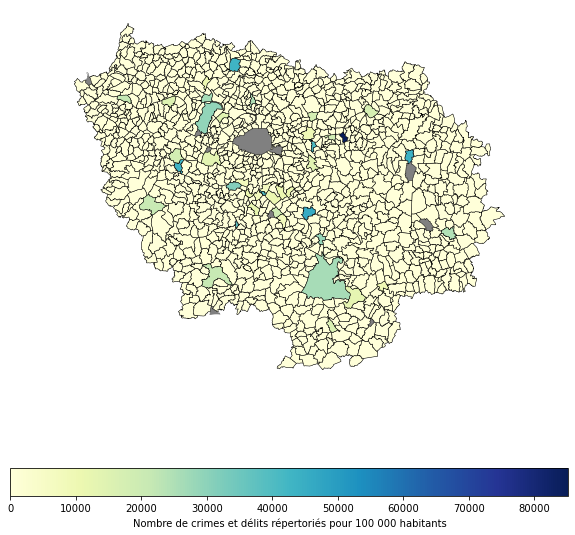

In [17]:
showgraph(communes,carto_crimes_delits,communes_idf,carto_crimes_delits_idf,'Crim_Del_PN_GN_hab','YlGnBu','Nombre de crimes et délits répertoriés pour 100 000 habitants')

# 4) Analyse univariée 

In [18]:
print('*'*100)
print('*'*100)
print("4 - Analyse univariée avec un diagramme en boîte pour chaque variable explicative")

****************************************************************************************************
****************************************************************************************************
4 - Analyse univariée avec un diagramme en boîte pour chaque variable explicative


In [23]:
fig = px.box(donnees_2018_com_hab, y="TP6018",hover_data=[ 'NCC'], labels=dict(TP6018 = 'Taux de pauvreté monétaire au seuil de 60%'))

fig.write_html('figure_TP6018_com.html', auto_open=True)
display(HTML("figure_TP6018_com.html"))

In [24]:
fig2 = px.box(donnees_2018_com_hab, y="MED18",hover_data=[ 'NCC'],labels=dict(MED18 = 'Niveau de vie médian'))

fig2.write_html('figure_MED18_com.html', auto_open=True)
display(HTML("figure_MED18_com.html"))

In [27]:
fig3= px.box(donnees_2018_com_hab, y="RD18",hover_data=[ 'NCC'], labels=dict(RD18 = 'Ratio inter-décile'))

fig3.write_html('figure_RD_2018_com.html', auto_open=True)
display(HTML("figure_RD_2018_com.html"))

In [26]:
fig4 = px.box(donnees_2018_com_hab, y="tx_chom1524",hover_data=[ 'NCC'], labels=dict(T1_2018 = 'Taux de chômage'))

fig4.write_html('figure_tx_chom1524_com.html', auto_open=True)
display(HTML("figure_tx_chom1524_com.html"))

In [30]:
fig5 = px.box(donnees_2018_com_hab, y="NbBoucheriesParComHab",hover_data=[ 'NCC'], labels=dict(NbBoucheriesParComHab = 'Nombre de boucheries pour 100 000 habitants'))

fig5.write_html('figure_Nb_Boucherie_dep_hab_com.html', auto_open=True)
display(HTML("figure_Nb_Boucherie_dep_hab_com.html"))

print("!!!!! petit problème pour la règle de trois sur 100 000 habitants, il faudrait pour les petites communes (<100 000 hab) garder le chiffre !!!!!")

In [29]:
fig7 = px.box(donnees_2018_com_hab, y="Crim_Del_PN_GN_hab",hover_data=[ 'NCC'], labels=dict(Crim_Del_PN_GN_hab= 'Nombre de crimes et délits reportés pour 100 000 habitants'))

fig7.write_html('figure_Crim_Del_PN_GN_hab_com.html', auto_open=True)
display(HTML("figure_Crim_Del_PN_GN_hab_com.html"))
print("!!!!! petit problème pour la règle de trois sur 100 000 habitants, il faudrait pour les petites communes (<100 000 hab) garder le chiffre !!!!!")